### Import packages and extract data

In [23]:
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import numpy as np

import nltk
from nltk.tokenize import sent_tokenize
from plotly.subplots import make_subplots

In [2]:
data_path = 'YOUR PATH TO DATA IN CSV'

In [3]:
df = pd.read_csv(data_path)

In [4]:
df.head()

,text,comment,lem_comments,score
0,how many summer y combinator fundees decided n...,going back to school is not identical with giv...,go back to school be not identical with give u...,0
1,how many summer y combinator fundees decided n...,there will invariably be those who don't see t...,there will invariably be those who do n't see ...,1
2,how many summer y combinator fundees decided n...,for me school is a way to be connected to what...,for me school be a way to be connect to what b...,2
3,how many summer y combinator fundees decided n...,i guess it really depends on how hungry you ar...,i guess it really depend on how hungry you be ...,3
4,how many summer y combinator fundees decided n...,i know pollground decided to go back to school...,i know pollground decide to go back to school ...,4


In [5]:
df['lem_comments'] = df['lem_comments'].str.replace(r'\W+', ' ', regex=True)

### EDA

#### 1. Text Length Count

In [6]:
#symbols
def get_length_symbols(text):
    return len(text)

#words
def get_length_words(text):
    return len(text.split())

#sentences
def get_sentences_count(text):
    return len(sent_tokenize(text))

#avg word len in comment
def get_avg_word_length(text):
    return np.mean(np.array([len(x) for x in text.split()]))

#avg sentence len
def get_avg_sentence_length(text):
    return np.mean(np.array([len(w.split()) for w in sent_tokenize(text)]))

In [7]:
df['lem_comments'] = df['lem_comments'].fillna('')

In [8]:
#очень долго отрабатывает, не советую запускать много раз

df['length_symbols_non_lem'] = df['comment'].apply(get_length_symbols)
df['length_words_non_lem'] = df['comment'].apply(get_length_words)
df['sentences_count_non_lem'] = df['comment'].apply(get_sentences_count)
df['avg_word_len_non_lem'] = df['comment'].apply(get_avg_word_length)
df['avg_sentence_len_not_lem'] = df['comment'].apply(get_avg_sentence_length)

#закоменченные не имеют смысла после удаления специальных символов
df['length_symbols_lem'] = df['lem_comments'].apply(get_length_symbols)
df['length_words_lem'] = df['lem_comments'].apply(get_length_words)
#df['sentences_count_lem'] = df['lem_comments'].apply(get_sentences_count)
df['avg_word_len_lem'] = df['lem_comments'].apply(get_avg_word_length)
#df['avg_sentence_len_lem'] = df['lem_comments'].apply(get_avg_sentence_length)

/Users/nikitapislegin/opt/anaconda3/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,


In [14]:
df_zero = df[df['score'] == 0]
df_one = df[df['score'] == 1]
df_two = df[df['score'] == 2]
df_three = df[df['score'] == 3]
df_four = df[df['score'] == 4]

#### Text len in words

In [65]:
fig = make_subplots(rows=5, cols=1, shared_xaxes=True)

fig.add_trace(go.Histogram(
    x=df_zero['length_words_lem']
), row=1, col=1)

fig.add_trace(go.Histogram(
    x=df_one['length_words_lem']
), row=2, col=1)

fig.add_trace(go.Histogram(
    x=df_two['length_words_lem']
), row=3, col=1)

fig.add_trace(go.Histogram(
    x=df_three['length_words_lem']
), row=4, col=1)

fig.add_trace(go.Histogram(
    x=df_four['length_words_lem']
), row=5, col=1)

fig.update_layout(
    height=1000, 
    width=800,
    xaxis_range=[0, 800]
)

In [48]:
#Сравнение медиан
zero_median = np.median(df_zero['length_words_lem'])
one_median = np.median(df_one['length_words_lem'])
two_median = np.median(df_two['length_words_lem'])
three_median = np.median(df_three['length_words_lem'])
four_median = np.median(df_four['length_words_lem'])
print("Median: ")
print(zero_median, one_median, two_median, three_median, four_median)
arr_median = [zero_median, one_median, two_median, three_median, four_median]

#Сравнение средних
zero_mean = round(np.mean(df_zero['length_words_lem']), 0)
one_mean = round(np.mean(df_one['length_words_lem']), 0)
two_mean = round(np.mean(df_two['length_words_lem']), 0)
three_mean = round(np.mean(df_three['length_words_lem']), 0)
four_mean = round(np.mean(df_four['length_words_lem']), 0)
print("Mean: ")
print(zero_mean, one_mean, two_mean, three_mean, four_mean)
arr_mean = [zero_mean, one_mean, two_mean, three_mean, four_mean]

#80 перцентиль (можно поэкспериментировать с другими)
zero_80perc = np.quantile(a=df_zero['length_words_lem'], q=0.8)
one_80perc = np.quantile(a=df_one['length_words_lem'], q=0.8)
two_80perc = np.quantile(a=df_two['length_words_lem'], q=0.8)
three_80perc = np.quantile(a=df_three['length_words_lem'], q=0.8)
four_80perc = np.quantile(a=df_four['length_words_lem'], q=0.8)
print("80 quantile: ")
print(zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc)
arr_80perc = [zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc]

Median: 
99.0 68.0 54.0 45.0 38.0
Mean: 
141.0 97.0 78.0 67.0 58.0
80 quantile: 
208.0 143.0 115.0 99.0 86.0


In [55]:
#перенесем это на график
#Для трех статистик тенденция сохраняется
score_arr = [0, 1, 2, 3, 4]

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_median
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_mean
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_80perc
))

fig.update_layout(
    xaxis_title = 'Score',
    yaxis_title = 'Word count'
)

fig.show()

#### Кол-во символов

In [ ]:
#Для начала проверим корреляцию признаков между собой
round(df[['length_words_lem', 'length_symbols_lem']].corr(), 3)

<AxesSubplot:xlabel='length_words_lem', ylabel='length_symbols_lem'>

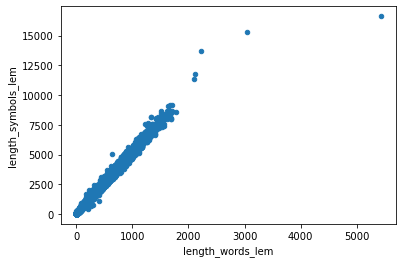

In [62]:
df.plot.scatter(x='length_words_lem', y='length_symbols_lem')

#### Средняя длина слова и предложения

In [69]:
fig = make_subplots(rows=5, cols=1, shared_xaxes=True)

fig.add_trace(go.Histogram(
    x=df_zero['avg_word_len_lem']
), row=1, col=1)

fig.add_trace(go.Histogram(
    x=df_one['avg_word_len_lem']
), row=2, col=1)

fig.add_trace(go.Histogram(
    x=df_two['avg_word_len_lem']
), row=3, col=1)

fig.add_trace(go.Histogram(
    x=df_three['avg_word_len_lem']
), row=4, col=1)

fig.add_trace(go.Histogram(
    x=df_four['avg_word_len_lem']
), row=5, col=1)

fig.update_layout(
    height=1000, 
    width=800,
    xaxis_range=[0, 8]
)

In [76]:
#Сравнение медиан
zero_median = round(np.nanmedian(df_zero['avg_word_len_lem']), 1)
one_median = round(np.nanmedian(df_one['avg_word_len_lem']), 1)
two_median = round(np.nanmedian(df_two['avg_word_len_lem']), 1)
three_median = round(np.nanmedian(df_three['avg_word_len_lem']), 1)
four_median = round(np.nanmedian(df_four['avg_word_len_lem']), 1)
print("Median: ")
print(zero_median, one_median, two_median, three_median, four_median)
arr_median = [zero_median, one_median, two_median, three_median, four_median]

#Сравнение средних
zero_mean = round(np.mean(df_zero['avg_word_len_lem']), 0)
one_mean = round(np.mean(df_one['avg_word_len_lem']), 0)
two_mean = round(np.mean(df_two['avg_word_len_lem']), 0)
three_mean = round(np.mean(df_three['avg_word_len_lem']), 0)
four_mean = round(np.mean(df_four['avg_word_len_lem']), 0)
print("Mean: ")
print(zero_mean, one_mean, two_mean, three_mean, four_mean)
arr_mean = [zero_mean, one_mean, two_mean, three_mean, four_mean]

#80 перцентиль (можно поэкспериментировать с другими)
zero_80perc = round(np.nanquantile(a=df_zero['avg_word_len_lem'], q=0.8), 1)
one_80perc = round(np.nanquantile(a=df_one['avg_word_len_lem'], q=0.8), 1)
two_80perc = round(np.nanquantile(a=df_two['avg_word_len_lem'], q=0.8), 1)
three_80perc = round(np.nanquantile(a=df_three['avg_word_len_lem'], q=0.8), 1)
four_80perc = round(np.nanquantile(a=df_four['avg_word_len_lem'], q=0.8), 1)
print("80 quantile: ")
print(zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc)
arr_80perc = [zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc]

Median: 
4.2 4.2 4.1 4.1 4.1
Mean: 
4.0 4.0 4.0 4.0 4.0
80 quantile: 
4.5 4.5 4.5 4.5 4.5


Из вида распределения и равенства среднего и медианы делаем вывод, что распределение боизко к нормальному с одинаковыми средними, а значит никакой полезной информации из этого получить мы не сможем

In [78]:
#Ну и этот график говорит нам о бесполезности данного признака
score_arr = [0, 1, 2, 3, 4]

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_median
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_mean
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_80perc
))

fig.update_layout(
    xaxis_title = 'Score',
    yaxis_title = 'Word count'
)

fig.show()

#### Ну и на всякий случай: смотрим кол-во предложений ( здесь берем результат без обработки )

In [84]:
fig = make_subplots(rows=5, cols=1, shared_xaxes=True)

fig.add_trace(go.Histogram(
    x=df_zero['sentences_count_non_lem']
), row=1, col=1)

fig.add_trace(go.Histogram(
    x=df_one['sentences_count_non_lem']
), row=2, col=1)

fig.add_trace(go.Histogram(
    x=df_two['sentences_count_non_lem']
), row=3, col=1)

fig.add_trace(go.Histogram(
    x=df_three['sentences_count_non_lem']
), row=4, col=1)

fig.add_trace(go.Histogram(
    x=df_four['sentences_count_non_lem']
), row=5, col=1)

fig.update_layout(
    height=1000, 
    width=800,
    xaxis_range=[0, 40]
)

In [87]:
#выглядит очень похоже на кол-во слов, посмотрим на корреляции всех сгенерированных признаков
round(df[['length_symbols_non_lem', 'length_words_non_lem', 'sentences_count_non_lem',
          'avg_word_len_non_lem', 'avg_sentence_len_not_lem', 'length_symbols_lem',
          'length_words_lem', 'avg_word_len_lem']].corr(), 3)

#Снова видим высокую корреляцию, значит можем вместо этого использовать кол-во слов

,length_symbols_non_lem,length_words_non_lem,sentences_count_non_lem,avg_word_len_non_lem,avg_sentence_len_not_lem,length_symbols_lem,length_words_lem,avg_word_len_lem
length_symbols_non_lem,1.000,0.986,0.834,-0.020,0.288,0.987,0.982,0.021
length_words_non_lem,0.986,1.000,0.850,-0.070,0.301,0.995,0.998,-0.020
sentences_count_non_lem,0.834,0.850,1.000,-0.059,-0.038,0.845,0.851,-0.037
avg_word_len_non_lem,-0.020,-0.070,-0.059,1.000,-0.072,-0.060,-0.065,0.139
avg_sentence_len_not_lem,0.288,0.301,-0.038,-0.072,1.000,0.282,0.294,-0.008
length_symbols_lem,0.987,0.995,0.845,-0.060,0.282,1.000,0.996,0.015
length_words_lem,0.982,0.998,0.851,-0.065,0.294,0.996,1.000,-0.023
avg_word_len_lem,0.021,-0.020,-0.037,0.139,-0.008,0.015,-0.023,1.000


#### Длина предложения

In [90]:
fig = make_subplots(rows=5, cols=1, shared_xaxes=True)

fig.add_trace(go.Histogram(
    x=df_zero['avg_sentence_len_not_lem']
), row=1, col=1)

fig.add_trace(go.Histogram(
    x=df_one['avg_sentence_len_not_lem']
), row=2, col=1)

fig.add_trace(go.Histogram(
    x=df_two['avg_sentence_len_not_lem']
), row=3, col=1)

fig.add_trace(go.Histogram(
    x=df_three['avg_sentence_len_not_lem']
), row=4, col=1)

fig.add_trace(go.Histogram(
    x=df_four['avg_sentence_len_not_lem']
), row=5, col=1)

fig.update_layout(
    height=1000, 
    width=800,
    xaxis_range=[0, 100]
)

In [91]:
#Сравнение медиан
zero_median = round(np.nanmedian(df_zero['avg_sentence_len_not_lem']), 1)
one_median = round(np.nanmedian(df_one['avg_sentence_len_not_lem']), 1)
two_median = round(np.nanmedian(df_two['avg_sentence_len_not_lem']), 1)
three_median = round(np.nanmedian(df_three['avg_sentence_len_not_lem']), 1)
four_median = round(np.nanmedian(df_four['avg_sentence_len_not_lem']), 1)
print("Median: ")
print(zero_median, one_median, two_median, three_median, four_median)
arr_median = [zero_median, one_median, two_median, three_median, four_median]

#Сравнение средних
zero_mean = round(np.mean(df_zero['avg_sentence_len_not_lem']), 0)
one_mean = round(np.mean(df_one['avg_sentence_len_not_lem']), 0)
two_mean = round(np.mean(df_two['avg_sentence_len_not_lem']), 0)
three_mean = round(np.mean(df_three['avg_sentence_len_not_lem']), 0)
four_mean = round(np.mean(df_four['avg_sentence_len_not_lem']), 0)
print("Mean: ")
print(zero_mean, one_mean, two_mean, three_mean, four_mean)
arr_mean = [zero_mean, one_mean, two_mean, three_mean, four_mean]

#80 перцентиль (можно поэкспериментировать с другими)
zero_80perc = round(np.nanquantile(a=df_zero['avg_sentence_len_not_lem'], q=0.8), 1)
one_80perc = round(np.nanquantile(a=df_one['avg_sentence_len_not_lem'], q=0.8), 1)
two_80perc = round(np.nanquantile(a=df_two['avg_sentence_len_not_lem'], q=0.8), 1)
three_80perc = round(np.nanquantile(a=df_three['avg_sentence_len_not_lem'], q=0.8), 1)
four_80perc = round(np.nanquantile(a=df_four['avg_sentence_len_not_lem'], q=0.8), 1)
print("80 quantile: ")
print(zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc)
arr_80perc = [zero_80perc, one_80perc, two_80perc, three_80perc, four_80perc]

Median: 
22.6 20.5 19.1 18.0 16.6
Mean: 
26.0 24.0 22.0 21.0 20.0
80 quantile: 
33.5 31.3 30.0 28.3 27.0


In [93]:
#Видна линейная зависимость
score_arr = [0, 1, 2, 3, 4]

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_median
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_mean
))

fig.add_trace(go.Scatter(
    x=score_arr,
    y=arr_80perc
))

fig.update_layout(
    xaxis_title = 'Score',
    yaxis_title = 'Word count'
)

fig.show()

Какой вывод из этого можно сделать? Кажется важными признаками могут быть кол-во слов во всем комментарии и среднее кол-во слов в предложении

### Что дальше? Частотный анализ - отдельные и слова и N-граммы, сори я спать